# Проект по исследованию рынка заведений общественного питания Москвы


Цель проекта

Необходимо изучить рынок заведений общественного питания в Москве, найти интересные особенности и презентовать полученные результаты. Нужно определить показатели для того, чтобы заказчики могли открыть заведение общественного питания: расположение, меню и цены. 


Описание данных

Предоставлен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.

Файл moscow_places.csv:
- name — название заведения;
- address — адрес заведения;
- category — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- hours — информация о днях и часах работы;
- lat — широта географической точки, в которой находится заведение;
- lng — долгота географической точки, в которой находится заведение;
- rating — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- price — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- avg_bill — строка, которая хранит среднюю стоимость заказа в виде диапазона;
- middle_avg_bill — число с оценкой среднего чека;
- middle_coffee_cup — число с оценкой одной чашки капучино;
- chain — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки): 0 — заведение не является сетевым, 1 — заведение является сетевым
- district — административный район, в котором находится заведение, например Центральный административный округ;
- seats — количество посадочных мест.

1. [Загрузка данных, изучение общей информации](#start)
2. [Предобработка данных](#preprocessing)
3. [Анализ](#analysis)
4. [Детализированное исследование: открытие кофейни.](#coffee)
1. [Презентация](#presentation) 
2. [Общий вывод](#result)

## Шаг 1. Загрузка данных, изучение общей информации. <a id="start"></a> 

В первую очередь необходимо импортировать библиотеки и открыть датасет.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from pandas.plotting import register_matplotlib_converters
import warnings
import plotly.express as px
import os
from plotly import graph_objects as go
register_matplotlib_converters()
import math as mth
from plotly import graph_objects as go

In [2]:
pth1 = '/datasets/moscow_places.csv'
if os.path.exists(pth1):
    places = pd.read_csv(pth1)
else:
    print('Something is wrong')
pd.options.display.max_colwidth = 130
places.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [3]:
places.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Данные успешно загружены, библиотеки импортированы. Можно приступать к предобработке. 

## Шаг 2. Предобработка данных. <a id="preprocessing"></a> 

Чтобы проверить, нет ли в данных пропусков и дубликатов, и проверить типы данных, я воспользуюсь заранее написанной функцией. 

In [4]:
def fix_and_check (dataset):
    dataset.columns = [x.lower().replace(' ', '_') for x in dataset.columns]
    dataset.columns
    print('Пропуски: ')
    print(dataset.isna().sum())
    print('*'*50)
    print('Дубликаты: ')
    print(dataset.duplicated().sum())
    print('*'*50)
    print('Типы данных: ')
    print(dataset.dtypes)
    return dataset

In [5]:
places = fix_and_check(places)

Пропуски: 
name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64
**************************************************
Дубликаты: 
0
**************************************************
Типы данных: 
name                  object
category              object
address               object
district              object
hours                 object
lat                  float64
lng                  float64
rating               float64
price                 object
avg_bill              object
middle_avg_bill      float64
middle_coffee_cup    float64
chain                  int64
seats                float64
dtype: object


В данных встречаются пропуски: в столбце hours, хранящем данные о днях и часах работы, price с категорией цен в заведении, avg_bill с средней стоимостью заказа в виде диапазона, middle_avg_bill и middle_coffee_cup с оценками среднего чека и чашки капучино и seats, хранящим количество посадочных мест. 

Удаление пропусков в столбцах нерационально: будет потеряно очень много строк с данными, и это может исказить результаты исследования. Визуализируем пропущенные значения на тепловой карте.

<AxesSubplot:>

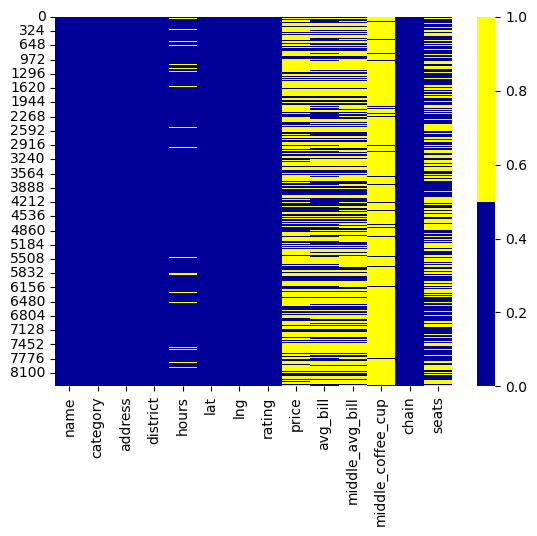

In [6]:
cols = places.columns
# желтый - пропущенные данные, синий - не пропущенные
colours = ['#000099', '#ffff00'] 
sns.heatmap(places[cols].isnull(), cmap=sns.color_palette(colours))

In [7]:
for col in places.columns:
    pct_missing = np.mean(places[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

name - 0%
category - 0%
address - 0%
district - 0%
hours - 6%
lat - 0%
lng - 0%
rating - 0%
price - 61%
avg_bill - 55%
middle_avg_bill - 63%
middle_coffee_cup - 94%
chain - 0%
seats - 43%


В датасете пропущено 58% значений в столбце price, 6% в столбце hours, 52% в столбце avg_bill, 60% в столбце middle_avg_bill и 93% в столбце middle_coffee_cup, 43% в столбце seats. 

Удалять такое количество строк или заполнять синтетическими данными бессмысленно и вредно. Но можно предположить, с чем связаны пропуски. 
- в столбце price категорию цен для своего заведения могли поставить не все пользователи;
- в столбцах avg_bill и middle_avg_bill пропуски также могли быть связаны с тем, что не все заведения решили опубликовать свои цены на Яндекс.Картах
- В столбце middle_coffee_cup больше всего пропусков, вероятно, помимо того, что не все заведения публикуют свои цены, не во всех заведениях делают капучино
- seats мог остаться пустым в связи с тем, что заведения не заполнили данные или количество посадочных мест менялось.
 
Наиболее подходящим решением в таким количеством пропусков будет просто заполнить их NaN значениями, в этом случае данные не исказятся и с ними можно будет проводить вычисления.

In [8]:
places['hours'] = places['hours'].fillna(np.nan)
places['price'] = places['price'].fillna(np.nan)
places['avg_bill'] = places['avg_bill'].fillna(np.nan)
places['middle_avg_bill'] = places['middle_avg_bill'].fillna(np.nan)
places['middle_coffee_cup'] = places['middle_coffee_cup'].fillna(np.nan)
places['seats'] = places['seats'].fillna(np.nan)

In [9]:
places = fix_and_check(places)

Пропуски: 
name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64
**************************************************
Дубликаты: 
0
**************************************************
Типы данных: 
name                  object
category              object
address               object
district              object
hours                 object
lat                  float64
lng                  float64
rating               float64
price                 object
avg_bill              object
middle_avg_bill      float64
middle_coffee_cup    float64
chain                  int64
seats                float64
dtype: object


Также нужно изменить тип данных в столбце seats: количество посадочных мест может быть только целым.

In [10]:
places['seats'] = places['seats'].astype('Int64')

Теперь нужно добавить столбцы: street с названиями улиц из столбца с адресом и is_24/7 с логическим обозначением, работает ли заведение ежедневно и круглосуточно.

In [11]:
words = ['улица','ул','переулок','шоссе','проспект','площадь','проезд',
         'село','аллея','бульвар','набережная','тупик','линия']
str_pat = r".*,\s*\b([^,]*?(?:{})\b[^,]*)[,$]+".format("|".join(words))
places['street'] = places['address'].str.extract(str_pat, flags=re.I)

In [12]:
places.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,<NA>,улица Дыбенко
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица Дыбенко
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45,Клязьминская улица
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>,улица Маршала Федоренко
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148,Правобережная улица


In [13]:
places['is_24/7'] = places['hours'].str.contains('ежедневно, круглосуточно')

In [14]:
places.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,<NA>,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148,Правобережная улица,False


Теперь, когда данные подготовлены, можно приступать к вычислениям.

## Шаг 3. Анализ данных. <a id="analysis"></a> 

Рассмотрим категории заведений, представленные в данных. 

In [15]:
categories = places.pivot_table(
    index=['category'],
    values='name',
    aggfunc='count').sort_values('name', ascending=False).reset_index()
categories

,category,name
0,кафе,2378
1,ресторан,2043
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


In [16]:
fig = px.bar(
    categories,
    x='category',
    y='name',
    
)
fig.update_layout(title='Распределение количества заведений по категориям')
fig

Больше всего представлено кафе. На втором месте рестораны, на третьем кофейни.

Теперь рассмотрим количество посадочных мест в местах по категориям. 

In [17]:
categories_seats = places.pivot_table(
    index=['category'],
    values='seats',
    aggfunc='sum').sort_values('seats', ascending=False).reset_index()
categories_seats

,category,seats
0,ресторан,154869
1,кафе,118770
2,кофейня,83511
3,"бар,паб",58281
4,пиццерия,40350
5,быстрое питание,34513
6,столовая,16359
7,булочная,13229


In [18]:
order_for_boxplot = (places
    .groupby('category')
    .agg({'seats' : 'median'})
    .sort_values(by='seats')
    .index)

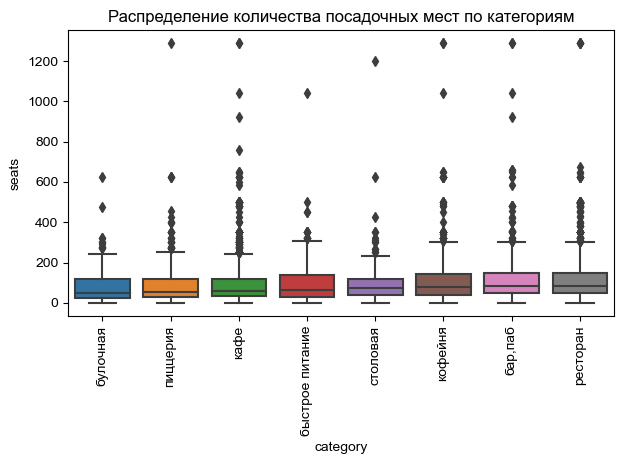

In [19]:
ax = sns.boxplot(x='category', y='seats', data=places, order=order_for_boxplot) 
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
sns.set(rc={'figure.figsize':(15,8)})
plt.title('Распределение количества посадочных мест по категориям')
plt.tight_layout()
plt.show()

Рассмотрим распределение количества посадочных мест ближе, чтобы понять картину в среднем.

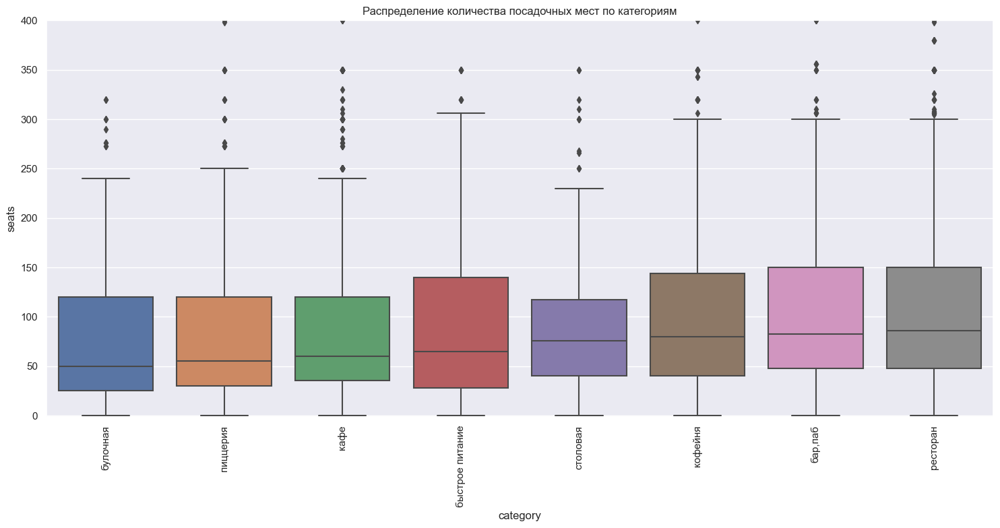

In [20]:
ax = sns.boxplot(x='category', y='seats', data=places, order=order_for_boxplot) 
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
sns.set(rc={'figure.figsize':(15,8)})
plt.title('Распределение количества посадочных мест по категориям')
plt.ylim([-1,400])
plt.tight_layout()
plt.show()

Так, в среднем заведения Москвы имеют около 70 посадочных мест. Наибольший разброс вместительности имеют заведения быстрого питания, наименьший - кафе. 

Изучим соотношение сетевых и несетевых заведений. 

In [21]:
places['chain'] = places['chain'].astype('int')

In [22]:
chaines = places.groupby('chain')['chain'].count()
chaines

chain
0    5201
1    3205
Name: chain, dtype: int64

Text(0.5, 1.0, 'Соотношение сетевых и несетевых заведений')

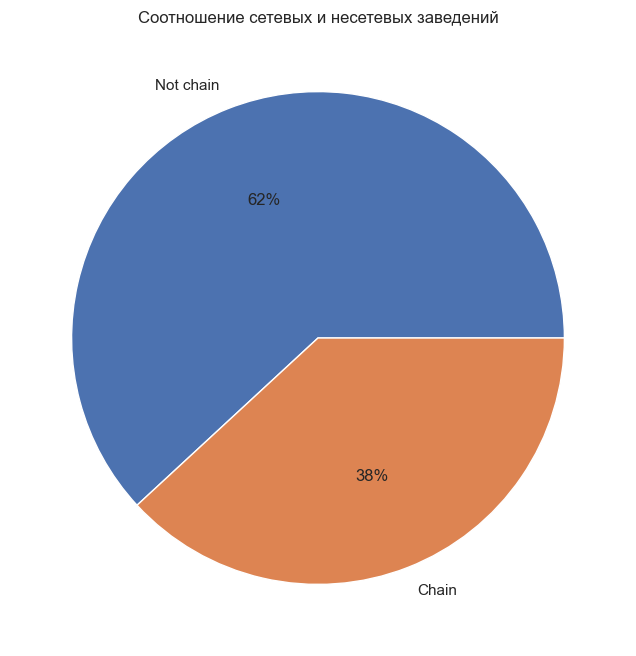

In [23]:
plt.pie(x=chaines, labels=['Not chain', 'Chain'], autopct='%.0f%%')
plt.title('Соотношение сетевых и несетевых заведений')

In [24]:
chains_categ = places.pivot_table(
    index=['category'],
    values='name',
    aggfunc='count').sort_values('name', ascending=False).reset_index()

In [25]:
chains_category = places.pivot_table(
    index=['category'],
    values='chain',
    aggfunc='sum').sort_values('chain', ascending=False).reset_index()

In [26]:
chains_categ['chains'] = chains_category['chain'] / chains_categ['name']
chains_categ.reset_index()

,index,category,name,chains
0,0,кафе,2378,0.327586
1,1,ресторан,2043,0.357318
2,2,кофейня,1413,0.509554
3,3,"бар,паб",765,0.431373
4,4,пиццерия,633,0.366509
5,5,быстрое питание,603,0.280265
6,6,столовая,315,0.498413
7,7,булочная,256,0.343750


In [27]:
fig = px.bar(chains_categ, x='category', y='chains')
fig.update_xaxes(tickangle=45)
fig.update_layout(title='Процент сетевых заведений по категориям')
fig.show()

Несетевых заведений в целом больше, 4 781 против 3089 сетевых. В основном несетевые заведения - кафе, рестораны. Кофеен больше сетевых, а заведения быстрого питания преимущественно не относятся ни к каким сетям. 

Найдём наиболее популярные сети в Москве. 

In [28]:
places.groupby('name')['name'].count().sort_values(ascending=False).head(15)

name
Кафе                                   189
Шоколадница                            120
Домино'с Пицца                          76
Додо Пицца                              74
One Price Coffee                        71
Яндекс Лавка                            69
Cofix                                   65
Prime                                   50
Хинкальная                              44
Шаурма                                  43
КОФЕПОРТ                                42
Кулинарная лавка братьев Караваевых     39
Теремок                                 38
Чайхана                                 37
Ресторан                                34
Name: name, dtype: int64

Визуализируем соотношение количества у 15 наиболее популярных сетей и остальных. 

In [29]:
data = places.pivot_table(
    index='name',
    values='chain', 
    aggfunc='sum').sort_values('chain', ascending=False).head(15)
data

,chain
name,
Шоколадница,120
Домино'с Пицца,76
Додо Пицца,74
One Price Coffee,71
Яндекс Лавка,69
Cofix,65
Prime,50
Хинкальная,44
КОФЕПОРТ,42


In [30]:
data_all = places.pivot_table(
    index='name',
    values='chain', 
    aggfunc='sum').sort_values('chain', ascending=False)

In [31]:
data.loc['Other', 'chain'] = data_all.iloc[15:].sum()[0]

15 популярнейших сетей занимают 26% всего рынка сетевых заведений в Москве. 

Text(0.5, 1.0, 'Соотношение 15 популярнейших сетей и остальных сетевых заведений')

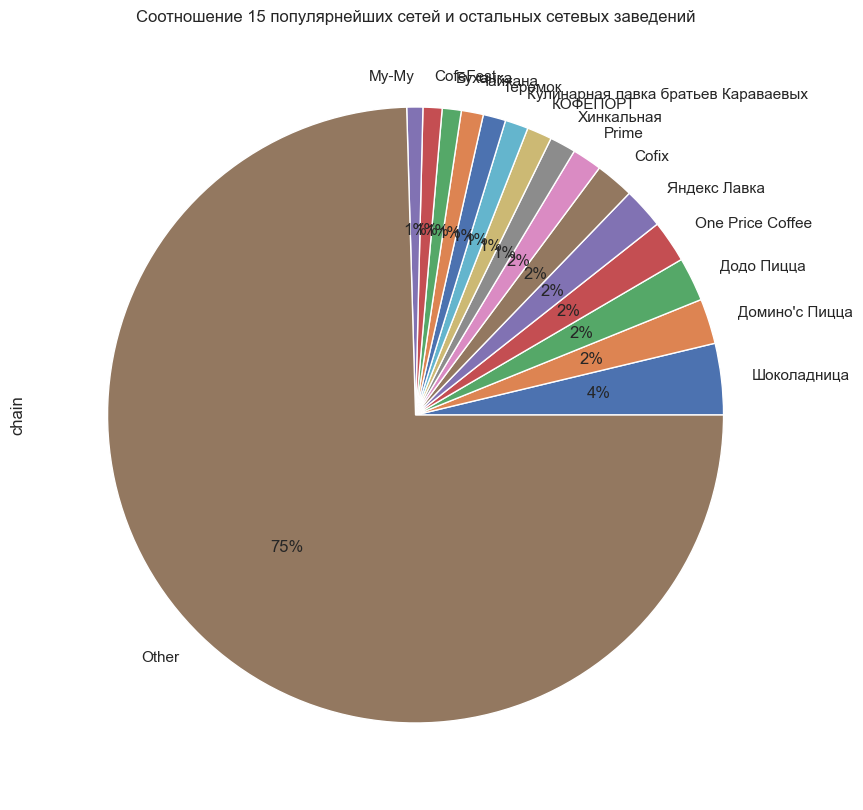

In [32]:
data.plot(kind='pie', y='chain', legend=False, figsize=(15,10), autopct='%.0f%%')
plt.title('Соотношение 15 популярнейших сетей и остальных сетевых заведений')

In [33]:
data = data.head(15).reset_index()
fig = px.bar(data, x='name', y='chain')
fig.update_xaxes(tickangle=45)
fig.update_layout(title='15 популярнейших сетей')
fig.show()

In [34]:
name_net = ['Шоколадница', 'Доминос Пицца', 'One Price Coffee', 'Додо Пицца', 'Яндекс Лавка', 'Cofix', 'Prime', 'КОФЕПОРТ', 'Кулинарная лавка братьев Караваевых', 'Хинкальная', 'Теремок', 'CofeFest', 'Буханка', 'Чайхана', 'Му-Му']
values = [120, 76, 74, 71, 68, 65, 50, 42, 39, 39, 38, 32, 31, 29, 27]

fig = go.Figure(data=[go.Pie(labels=name_net, values=values)])
fig.show() 

Среди 15 популярнейших сетей доминирует Шоколадница - 15% среди самых популярных и 4% от всего рынка. 

Популярнейшие сети: 4 сети кафе, 2 сети пиццерий, 4 сети кофеен, 4 сети ресторанов, 1 сеть булочных. 

Теперь проанализируем расположение заведений на карте.

In [35]:
from folium import Map, Marker
from folium.plugins import MarkerCluster
from folium.features import CustomIcon
from folium import Map, Choropleth

In [36]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    icon_url = 'https://img.icons8.com/?size=512&id=115346&format=png'  
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
places.apply(create_clusters, axis=1)

# выводим карту
m

На интерактивной карте видно, что самая большая концентрация заведений общепита в центре. В Люберцах их меньше всего. 

Посмотрим, как заведения распределяются по районам и категориям. 

In [37]:
data_dist = places.pivot_table(
    index=['district', 'category'],
    values='name',
    aggfunc='count').sort_values('name', ascending=False).head(15).reset_index()
data_dist

,district,category,name
0,Центральный административный округ,ресторан,670
1,Центральный административный округ,кафе,464
2,Центральный административный округ,кофейня,428
3,Центральный административный округ,"бар,паб",364
4,Юго-Восточный административный округ,кафе,282
5,Восточный административный округ,кафе,272
6,Северо-Восточный административный округ,кафе,269
7,Южный административный округ,кафе,264
8,Западный административный округ,кафе,239
9,Юго-Западный административный округ,кафе,238


In [38]:
fig = px.bar(data_dist, x='name', y='district', color='category', title='Распределение заведений по районам')
fig.show()

Больше всего заведений в Центральном административном округе. Там же находится большая часть баров и пабов. 

Визуализируем распределение средних рейтингов по категориям заведений. 

In [39]:
rates = places.pivot_table(
    index='category',
    values='rating', 
    aggfunc='mean').sort_values('rating', ascending=False).reset_index()
rates

,category,rating
0,"бар,паб",4.387712
1,пиццерия,4.301264
2,ресторан,4.290357
3,кофейня,4.277282
4,булочная,4.268359
5,столовая,4.211429
6,кафе,4.123886
7,быстрое питание,4.050249


In [40]:
fig = px.bar(rates, x='category', y='rating')
fig.update_xaxes(tickangle=45)
fig.update_layout(title='Средние рейтинги у разных категорий')
fig.show()

Самые высокие средние рейтинги у баров и пабов. В целом средние рейтинги не слишком различаются: у всех категорий заведений они между 4 и 4.5

Изучим средние рейтинги заведений на карте. 

In [41]:
rating_df = places.groupby('district', as_index=False)['rating'].agg('mean')
rating_df

,district,rating
0,Восточный административный округ,4.174185
1,Западный административный округ,4.181551
2,Северный административный округ,4.239778
3,Северо-Восточный административный округ,4.148260
4,Северо-Западный административный округ,4.208802
5,Центральный административный округ,4.377520
6,Юго-Восточный административный округ,4.101120
7,Юго-Западный административный округ,4.172920
8,Южный административный округ,4.184417


In [42]:
# подключаем модуль для работы с JSON-форматом
import json

# читаем файл и сохраняем в переменной
with open('/datasets/admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
    geo_json = json.load(f)

json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True)
state_geo = geo_json

In [43]:
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Самый высокий средний рейтинг в центре Москвы. Чем ближе к Люберцам и Мытищам, тем ниже он становится.

Найдём топ-15 улиц по количеству заведений на них, и построим график распределения количества заведений и их категорий по этим улицам. 

In [44]:
top15streets = places.pivot_table(
    index=['street'],
    values='name',
    aggfunc='count').sort_values('name', ascending=False).head(15).reset_index()
top15streets

,street,name
0,проспект Мира,184
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,75
8,Ленинградское шоссе,69
9,Люблинская улица,60


In [45]:
fig = px.bar(top15streets, x='street', y='name', title='Распределение заведений по 15 наиболее популярным улицам')
fig.show()

Больше всего заведений находится на проспекте Мира. 

In [46]:
fig_data = places.pivot_table(
    index=['street', 'category'],
    values='name',
    aggfunc='count').sort_values('name', ascending=False).head(26).reset_index()

In [47]:
fig = px.bar(fig_data, x='street', y='name', color='category', title='Распределение заведений по категориям на 15 наиболее популярных улицах')
fig.show()

Самые распространённые заведения на этих улицах - кафе и рестораны. Также много кофеен.

Найдём улицы, на которых находится только один объект общепита. 

In [48]:
places.groupby('street')['street'].count().sort_values()
only_one = places.pivot_table(
    index=['street'],
    values='name',
    aggfunc='count').sort_values('name', ascending=True).reset_index()
only_one = only_one.loc[only_one['name'] == 1]
only_one

,street,name
0,1-й Автозаводский проезд,1
1,Казарменный переулок,1
2,улица 8-я Линия,1
3,Инициативная улица,1
4,улица 800-летия Москвы,1
...,...,...
409,Большой Козловский переулок,1
410,Бобров переулок,1
411,1-й Грайвороновский проезд,1
412,улица Комдива Орлова,1


Всего 413 улиц, на которых расположено только одно заведение общественного питания. 

Изучим распределение среднего чека в заведении по районам.

In [49]:
bills_df = places.groupby('district', as_index=False)['middle_avg_bill'].agg('median')
bills_df

,district,middle_avg_bill
0,Восточный административный округ,575.0
1,Западный административный округ,1000.0
2,Северный административный округ,650.0
3,Северо-Восточный административный округ,500.0
4,Северо-Западный административный округ,700.0
5,Центральный административный округ,1000.0
6,Юго-Восточный административный округ,450.0
7,Юго-Западный административный округ,600.0
8,Южный административный округ,500.0


In [50]:
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=bills_df,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек в заведениях по районам',
).add_to(m)

# выводим карту
m

Дороже всего визит в общепит закономерно обходится в центре. Дешевле всего будет трапеза ближе к Мытищам или Люберцам. Любопытно, что на втором месте по чекам район по направлению к Одинцово, при той же удалённости от центра, что и самые недорогие районы. 

## Промежуточный вывод

По категориям заведения распределяются так:  25.5% и 25% занимают кафе и рестораны, на третьем месте кофейни - 17.8%. 9.49% занимают бары и пабы, пиццерии - 7.98%, заведения быстрого питания - 7.24%, и столовые и булочные по 3.89% и 3.16% соответственно .  

Посадочных мест в заведениях Москвы в среднем около 70, наибольший разброс вместительности у заведений быстрого питания, наименьший у кафе. 
Несетевых заведений в целом больше, 4 781 против 3089 сетевых. В основном несетевые заведения - кафе, рестораны. Кофеен больше сетевых, а пабы и бары преимущественно не относятся ни к каким сетям.

15 наиболее популярных сетей занимают 26% всего рынка сетевых заведений в Москве. Среди них доминирует Шоколадница - 15% от самых популярных и 4% от всего рынка. 

Популярнейшие сети: 4 сети кафе, 2 сети пиццерий, 4 сети кофеен, 4 сети ресторанов, 1 сеть булочных.

На картах видно, что наибольшая концентрация заведений в Центральном административном округе. В нём же расположена большая часть баров и пабов. Меньше всего заведений в Люберцах. 

Самый высокий средний рейтинг у заведений также в ЦАО. Ниже всего он ближе к Люберцам и Мытищам. 

На 15 наиболее популярных улицах расположено больше всего кафе и ресторанов. Также много кофеен. На проспекте Мира также много заведений быстрого питания. 

Улиц, на которых расположен только один объект общепита, всего 413. 

Средний чек на карте показывает, что наиболее высокие цены в среднем в Центральном административном округе. Самые низкие цены ближе к Мытищам и Люберцам. На втором месте по среднему чеку район у Одинцово при той же удалённости от центра, что и самые недорогие районы. 

## Шаг 4. Детализированное исследование: открытие кофейни. <a id="coffee"></a> 

Одна из целей исследования - изучить рынок кофеен в Москве, чтобы основатели фонда могли открыть хорошую и доступную кофейню. Для этого вынесем все кофейни в отдельный датасет и исследуем его. 

In [51]:
coffee = places.loc[places['category'] == 'кофейня']
coffee.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>,улица Маршала Федоренко,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,<NA>,NaN,False
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46,Коровинское шоссе,False
46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,1,<NA>,улица Маршала Федоренко,False
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,1,<NA>,улица Дыбенко,False


In [52]:
coffee.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1413 entries, 3 to 8400
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1413 non-null   object 
 1   category           1413 non-null   object 
 2   address            1413 non-null   object 
 3   district           1413 non-null   object 
 4   hours              1398 non-null   object 
 5   lat                1413 non-null   float64
 6   lng                1413 non-null   float64
 7   rating             1413 non-null   float64
 8   price              476 non-null    object 
 9   avg_bill           721 non-null    object 
 10  middle_avg_bill    200 non-null    float64
 11  middle_coffee_cup  521 non-null    float64
 12  chain              1413 non-null   int32  
 13  seats              751 non-null    Int64  
 14  street             1378 non-null   object 
 15  is_24/7            1398 non-null   object 
dtypes: Int64(1), float64(5),

Всего в Москве 1398 кофеен.

In [53]:
coffee.groupby('name')['name'].count().sort_values(ascending=False)

name
Шоколадница         119
One Price Coffee     71
Cofix                65
КОФЕПОРТ             42
CofeFest             31
                   ... 
Nord Coffee           1
O.K. Coffee           1
Oda coffee            1
Omg Coffee            1
Ялва                  1
Name: name, Length: 839, dtype: int64

In [54]:
map = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(map)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    icon_url = 'https://img.icons8.com/?size=512&id=AnE0Vo3dGzal&format=png'  
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
        icon=icon,
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
coffee.apply(create_clusters, axis=1)

# выводим карту
map

Больше всего кофеен расположено в Центральном административном округе - 406 заведений. 

In [55]:
coffee24_7 = coffee.loc[coffee['hours'] == 'ежедневно, круглосуточно']
coffee24_7

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
200,Wild Bean,кофейня,"Москва, Дмитровское шоссе, 107Е",Северный административный округ,"ежедневно, круглосуточно",55.878477,37.543426,3.5,NaN,NaN,NaN,NaN,1,20,Дмитровское шоссе,True
971,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, 116",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.867822,37.708853,4.0,NaN,NaN,NaN,NaN,1,25,Ярославское шоссе,True
1047,Wild Bean Cafe,кофейня,"Москва, Ярославское шоссе, вл3с3",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.851778,37.676423,4.5,NaN,Цена чашки капучино:140–200 ₽,NaN,170.0,1,<NA>,Ярославское шоссе,True
1214,Wild Bean Cafe,кофейня,"Москва, МКАД, 65-й километр, 8",Северо-Западный административный округ,"ежедневно, круглосуточно",55.813787,37.390701,4.3,NaN,NaN,NaN,NaN,1,<NA>,NaN,True
1291,Шоколадница,кофейня,"Москва, улица Народного Ополчения, 49, корп. 1",Северо-Западный административный округ,"ежедневно, круглосуточно",55.794815,37.494834,4.2,средние,Средний счёт:650–850 ₽,750.0,NaN,1,200,улица Народного Ополчения,True
1468,Кофе Хауз,кофейня,"Москва, Ленинградский проспект, 74",Северный административный округ,"ежедневно, круглосуточно",55.805239,37.516246,4.0,NaN,Цена чашки капучино:235–335 ₽,NaN,285.0,1,<NA>,Ленинградский проспект,True
1790,Кофемания,кофейня,"Москва, Ленинградский проспект, 37А, корп. 14, стр. 6",Северный административный округ,"ежедневно, круглосуточно",55.790899,37.542776,4.7,NaN,NaN,NaN,NaN,1,15,Ленинградский проспект,True
1825,You&coffee,кофейня,"Москва, улица Золоторожский Вал, 11, стр. 21",Северный административный округ,"ежедневно, круглосуточно",55.803924,37.582251,4.2,NaN,NaN,NaN,NaN,1,<NA>,улица Золоторожский Вал,True
1883,Кофемания,кофейня,"Москва, Лесная улица, 5",Центральный административный округ,"ежедневно, круглосуточно",55.777804,37.586346,4.4,высокие,Средний счёт:2000 ₽,2000.0,NaN,1,140,Лесная улица,True
2030,Cinnabon,кофейня,"Москва, Долгоруковская улица, 40",Центральный административный округ,"ежедневно, круглосуточно",55.778271,37.601991,4.2,NaN,NaN,NaN,NaN,1,230,Долгоруковская улица,True


In [56]:
coffee24_7.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59 entries, 200 to 7923
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               59 non-null     object 
 1   category           59 non-null     object 
 2   address            59 non-null     object 
 3   district           59 non-null     object 
 4   hours              59 non-null     object 
 5   lat                59 non-null     float64
 6   lng                59 non-null     float64
 7   rating             59 non-null     float64
 8   price              25 non-null     object 
 9   avg_bill           28 non-null     object 
 10  middle_avg_bill    13 non-null     float64
 11  middle_coffee_cup  15 non-null     float64
 12  chain              59 non-null     int32  
 13  seats              37 non-null     Int64  
 14  street             55 non-null     object 
 15  is_24/7            59 non-null     object 
dtypes: Int64(1), float64(5),

59 кофеен круглосуточные. Пользуются ли они популярностью? 

In [57]:
coffee['rating'].mean()

4.27728237791932

In [58]:
coffee24_7['rating'].mean()

4.206779661016949

Средний рейтинг кофеен - 4.27, круглосуточных - 4.2. Довольно высокий показатель, стоит рассмотреть вариант открытия круглосуточной кофейни - конкуренция здесь не такая высокая, но рейтинги хорошие. 

Посмотрим, как распределяются рейтинги кофеен на карте

In [59]:
coffee_rate = coffee.groupby('district', as_index=False)['rating'].agg('mean')
coffee_rate

,district,rating
0,Восточный административный округ,4.282857
1,Западный административный округ,4.195333
2,Северный административный округ,4.291710
3,Северо-Восточный административный округ,4.216981
4,Северо-Западный административный округ,4.325806
5,Центральный административный округ,4.336449
6,Юго-Восточный административный округ,4.225843
7,Юго-Западный административный округ,4.283333
8,Южный административный округ,4.232824


In [60]:
Choropleth(
    geo_data=state_geo,
    data=coffee_rate,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(map)

map

Рейтинг кофеен на карте довольно высокий. В районах Мытищ и Долгопрудного он ниже, чем в других районах, но стоит учитывать, что разброс на карте от 4.19 до 4.34, то есть он всё ещё достаточно высокий. 

Посмотрим, на какую стоимость чашки капучино лучше ориентироваться при открытии. 

In [61]:
coffee['middle_coffee_cup'].mean()

175.0556621880998

Средняя цена чашки капучино в московских кофейнях - 174.8 ед. Стоит ориентироваться на цену около 170: близко к среднему, всё ещё выгодно для клиентов.

## Промежуточный вывод

Всего в Москве расположено 1398 кофеен. Самая большая концентрация кофеен в Центральном административном округе - 406 заведений. В среднем рейтинг у кофеен 4.27, у круглосуточных кофеен - 4.2. Всего круглосуточных кофеен только 59. Самые высокие рейтинги у кофеен в центре. Средняя цена чашки капучино - 174.

Рекомендации для открытия нового заведения

- оптимальным расположением для кофейни будет центральный административный округ. Конкуренция в нём достаточно высокая, но также и высокая посещаемость и большая концентрация людей;
- круглосуточная кофейня была бы удачным выбором, поскольку круглосуточных кофеен достаточно мало, при этом у них высокий рейтинг
- стоит ориентироваться на цену чашки капучино около 170 рублей. 

## Шаг 5. Подготовка презентации. <a id="presentation"></a> 

Презентация: <https://disk.yandex.ru/i/bqoq6s4OnnCjAA>

# Общий вывод <a id="result"></a> 

По категориям заведения распределяются так:  25.5% и 25% занимают кафе и рестораны, на третьем месте кофейни - 17.8%. 9.49% занимают бары и пабы, пиццерии - 7.98%, заведения быстрого питания - 7.24%б и столовые и булочные по 3.89% и 3.16% соответственно .  

Посадочных мест в заведениях Москвы в среднем около 70, наибольший разброс вместительности у заведений быстрого питания, наименьший у кафе. 
Несетевых заведений больше, 4 781 против 3089 сетевых. В основном несетевые заведения - кафе, рестораны. Кофеен больше сетевых, а пабы и бары преимущественно не относятся ни к каким сетям.

15 наиболее популярных сетей занимают 26% всего рынка сетевых заведений в Москве. Среди них доминирует Шоколадница - 15% от самых популярных и 4% от всего рынка. 

Популярнейшие сети: 4 сети кафе, 2 сети пиццерий, 4 сети кофеен, 4 сети ресторанов, 1 сеть булочных.

На картах видно, что наибольшая концентрация заведений в Центральном административном округе. В нём же расположена большая часть баров и пабов. Меньше всего заведений в Люберцах. 

Самый высокий средний рейтинг у заведений также в ЦАО. Ниже всего он ближе к Люберцам и Мытищам. 

На 15 наиболее популярных улицах расположено больше всего кафе и ресторанов. Также много кофеен. На проспекте Мира также много заведений быстрого питания. 

Улиц, на которых расположен только один объект общепита, всего 413. 

Средний чек на карте показывает, что наиболее высокие цены в среднем в Центральном административном округе. Самые низкие цены ближе к Мытищам и Люберцам. На втором месте по среднему чеку район у Одинцово при той же удалённости от центра, что и самые недорогие районы. 

Исследование кофеен

Всего в Москве расположено 1398 кофеен. Самая большая концентрация кофеен в Центральном административном округе - 406 заведений. В среднем рейтинг у кофеен 4.27, у круглосуточных кофеен - 4.2. Всего круглосуточных кофеен только 59. Самые высокие рейтинги у кофеен в центре. Средняя цена чашки капучино - 174.

Рекомендации для открытия нового заведения

- оптимальным расположением для кофейни будет центральный административный округ. Конкуренция в нём достаточно высокая, но также и высокая посещаемость и большая концентрация людей;
- круглосуточная кофейня была бы удачным выбором, поскольку круглосуточных кофеен достаточно мало, при этом у них высокий рейтинг
- стоит ориентироваться на цену чашки капучино около 170 рублей. 